In [1]:
import torch
import torchvision
import torch.optim as optim
import argparse
import matplotlib
import torch.nn as nn
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import model
import model_conv
import model_conv_bigger
from tqdm import tqdm
from torchvision import datasets
from torch.utils.data import DataLoader
from torchvision.utils import save_image
matplotlib.style.use('ggplot')



In [2]:
import numpy as np
import matplotlib.pyplot as plt
import torch

import os

os.chdir('/home/axtr7550/Chromosome_project/cellbgnet/')
import cellbgnet
import cellbgnet.utils

from cellbgnet.datasets import DataSimulator
from cellbgnet.utils.hardware import cpu, gpu
from cellbgnet.model import CellBGModel
from cellbgnet.simulation.psf_kernel import SMAPSplineCoefficient
from cellbgnet.generic.emitter import EmitterSet
from cellbgnet.train_loss_infer import generate_probmap_cells

os.chdir('/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/src')

from skimage.io import imread
from skimage.measure import label
import random
import edt
from skimage.filters import gaussian
from scipy.ndimage import rotate
import random
import pickle
import pathlib
from pathlib import Path
#%matplotlib qt5


In [3]:
print(os.getcwd())


/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/src


In [4]:
import torchvision.transforms.functional as F
plt.rcParams["savefig.bbox"] = 'tight'


def show(imgs, title=None):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fig, axs = plt.subplots(ncols=len(imgs), squeeze=False, constrained_layout=True)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
    if title is not None:
        fig.suptitle(title, color='white', fontsize=25)

In [5]:
param_file = '../../../cellbgnet/utils/reference_files/reference_Axel.yaml'
param = cellbgnet.utils.param_io.ParamHandling().load_params(param_file)


In [6]:
psf_params = param.PSF.to_dict()
simulation_params = param.Simulation.to_dict()
hardware_params = param.Hardware.to_dict()
train_size = simulation_params['train_size']
calib_file = psf_params['calib_file']


In [7]:
psf_size = 41
xextent = [-0.5, 127.5]
yextent = [-0.5, 127.5]
zextent = [-400, 400]
scale = torch.tensor([(xextent[1] - xextent[0]),
                      (yextent[1] - yextent[0]),
                      (zextent[1] - zextent[0])])
shift = torch.tensor([xextent[0], yextent[0], zextent[0]])



In [8]:
psf = SMAPSplineCoefficient(calib_file=calib_file).init_spline(
xextent=[-0.5, 639.5], yextent=[-0.5, 639.5], img_shape=[640, 640], device='cuda', 
roi_size=None, roi_auto_center=None, normalize=True)


INITIATING CUDA IMPLEMENTATION


In [9]:
epochs = 40
batch_size = 128
lr = 0.0001
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [10]:
# transforms
transform = transforms.Compose([
    transforms.ToTensor(),
])


In [11]:
# train and validation data
train_data = datasets.MNIST(
    root='../input/data',
    train=True,
    download=True,
    transform=transform
)
val_data = datasets.MNIST(
    root='../input/data',
    train=False,
    download=True,
    transform=transform
)


In [12]:
def create_psf_batch(size=64, batch_size=100, noise_scale=0.1, vary_intensity=True, vary_position=True):
    
    batch_size = 100
    if vary_position:
        xyz = torch.normal(size/2, size/15,(batch_size,3))
    else:
        xyz = torch.ones((batch_size,3))*32

    xyz[...,2] = (torch.rand((batch_size, ))-0.5)*1000
    xyz = xyz.view(-1, 3)
    
    offset = torch.arange(0, 640, 64)
    x_offset = offset.repeat_interleave(10)
    y_offset = offset.repeat(10)
    xy_offset = torch.cat((x_offset.view(-1, 1), y_offset.view(-1,1)), dim=1)
    xyz[:,:2] = xyz[:,:2] + xy_offset


    
    photon_scale = 2000
    if vary_intensity:
        photons = torch.normal(1500.0, 500.0,(xyz.shape[0],))
    else:
        photons = torch.ones((xyz.shape[0], ))*photon_scale

    photons = photons.clip(300.0, 4000.0)
    
    full = psf.forward(xyz, photons)


    frames = torch.stack([full[0,n//10*64:(n//10+1)*64, n%10*64:(n%10+1)*64] for n in range(batch_size)])
    max_val = torch.max(frames)
    noise = torch.normal(0.0,noise_scale*33.0,(frames.shape))
    noisy = frames + noise
    frames = frames/33.0
    noisy = noisy/33.0
    frames = frames.clip(0.0, 1.0)
    noisy = noisy.clip(0.0, 1.0)

    frames = frames.unsqueeze(1)
    noisy = noisy.unsqueeze(1)

    return frames,noisy, xyz, photons


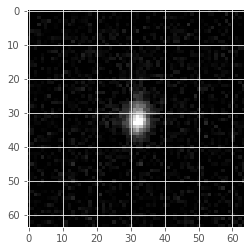

In [22]:
frames, noisy,_, _ = create_psf_batch(size = 64,noise_scale=0.05, vary_position=False, vary_intensity=False)
plt.imshow(noisy[1,0,...], cmap= 'gray', vmin=0, vmax=1)



In [14]:
def create_batch(size=28, batch_size=64):
    batch = torch.zeros([batch_size,1,size,size])
    xys = torch.tensor([[0], [0]])
    xs = torch.randint(0, size, (batch_size,))
    ys = torch.randint(0, size,  (batch_size,))
    xys = torch.concatenate([xs.view(-1,1), ys.view(-1,1)], dim=1)
    batch[torch.arange(batch.shape[0]),0, xs, ys] = 1
    return batch, xys

In [15]:
#model = torch.load("/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/VAE_3D_conv_B4.pt")
lr = 0.001
model = model_conv_bigger.VAE_CNN_version_2().to(device)
optimizer = optim.AdamW(model.parameters(), lr=lr)
criterion = nn.BCELoss(reduction='sum')
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                         mode='min',
                                                         factor=0.2,
                                                         patience=20,
                                                         min_lr=5e-5)

173056
(64, 64)


In [16]:
#model = torch.load("/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/VAE_conv_PSF_1.pt")


In [23]:
def final_loss(bce_loss, mu, logvar, beta=1):
    """
    This function will add the reconstruction loss (BCELoss) and the 
    KL-Divergence.
    KL-Divergence = 0.5 * sum(1 + log(sigma^2) - mu^2 - sigma^2)

    A beta here will affect how much the KLD matters

    :param bce_loss: recontruction loss
    :param mu: the mean from the latent vector
    :param logvar: log variance from the latent vector
    """
    BCE = bce_loss 
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    

    return BCE + KLD*beta, BCE, KLD

In [24]:
def fit(model, dataloader, beta=1, noise_scale=0, vary_intensity=False, vary_position=False, z_dim=1):
    model.train()
    running_loss = 0.0
    for i in range((64*64)//batch_size):
        data = create_psf_batch(noise_scale=noise_scale, 
                                vary_intensity=vary_intensity, 
                                vary_position=vary_position)
        
        data, noisy, xyz, _ = data
        data = data.to(device)
        noisy = noisy.to(device)
        #data = data.view(data.size(0), -1)
        optimizer.zero_grad()
        reconstruction, mu, logvar, _ = model(noisy)
        bce_loss = criterion(reconstruction, noisy) # Reconstructs the noisy image
        loss, BCE, KLD = final_loss(bce_loss, mu, logvar, beta)
        running_loss += loss.item()
        loss.backward()
        optimizer.step()

    train_loss = running_loss/(64*64)
    return train_loss

In [26]:
def validate(model, dataloader, noise_scale=0, beta=1, vary_intensity=False, vary_position=False, z_dim=1):
    model.eval()
    running_loss = 0.0
    running_BCE = 0.0
    running_KLD = 0.0
    with torch.no_grad():
        for i in range((64*64)//batch_size):
            data = create_psf_batch(noise_scale=noise_scale, 
                                    vary_intensity=vary_intensity, 
                                    vary_position=vary_position)
            
            
            data, noisy, xys, _ = data
            data = data.to(device)
            noisy = noisy.to(device)
            #data = data.view(data.size(0), -1)
            reconstruction, mu, logvar, _ = model(noisy)
            bce_loss = criterion(reconstruction, noisy) # Reconstructs the noisy image
            loss, BCE, KLD = final_loss(bce_loss, mu, logvar)
            running_loss += loss.item()
            running_BCE += BCE.item()
            running_KLD += KLD.item()
            # save the last batch input and output of every epoch
            save_mod = (1+1*epoch//10) if epoch < 100 else 10*(epoch//100)

            if ((64*64)//batch_size - 1) and (epoch % save_mod == 0):
                #plt.imshow(data.view(batch_size, 1, 64, 64)[0,0,...].cpu().detach().numpy(), cmap='gray')
                num_rows = 8
                both = torch.cat((noisy.view(batch_size, 1, 64, 64)[:8],data.view(batch_size, 1, 64, 64)[:8], 
                                  reconstruction.view(batch_size, 1, 64, 64)[:8]))
                save_image(both.cpu(), f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/varied_intensity_aligned/psf_resnet_zonly_aligned_B{beta}_I{vary_intensity}_P{vary_position}_N{noise_scale}_zDim{z_dim}_{epoch}.png", nrow=num_rows, pad_value=1)

    val_loss = running_loss/(64*64)
    bce_loss_tot = running_BCE/(64*64)
    kld_loss = running_KLD/(64*64)
    return val_loss, mu, xys, bce_loss_tot, kld_loss



In [20]:
#model = torch.load("/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_VAE.pt")

#lr = 0.0001
#model = model_conv_bigger.VAE(zDim=3, imsize=(64,64)).to(device)
#optimizer = optim.AdamW(model.parameters(), lr=lr)
#criterion = nn.BCELoss(reduction='sum')


In [27]:
train_loss = []
val_loss = []
bce_loss_list = []
kld_loss_list = []


noise_scales = [0.01, 0.1, 0.2, 0.35,  0.5]
z_dims = [1]
vary_intensities = [False]
vary_positions = [False]
i = 0
for noise_scale in noise_scales:
        for vary_intensity in vary_intensities:
            for vary_position in vary_positions:
                for z_dim in z_dims:
                  
                    
                    beta = 1
                    batch_size = 100
                    
                    curr = 0
                    epochs = 3001-curr

                    lr = 0.001
                    model = model_conv_bigger.VAE_CNN_version_2(zDim=z_dim).to(device)
                    optimizer = optim.AdamW(model.parameters(), lr=lr)
                    criterion = nn.BCELoss(reduction='sum')
                    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                                        mode='min',
                                                                        factor=0.2,
                                                                        patience=20,
                                                                        min_lr=5e-5)


                    for epoch in range(curr, curr+epochs+1):
                        print(f"Epoch {epoch+1} of {epochs},beta = {beta}, noise_scale = {noise_scale}, z_dim = {z_dim}, Intensity = {vary_intensity}, Positions = {vary_position}")
                        train_epoch_loss = fit(model, 0, beta=beta, noise_scale=noise_scale, vary_intensity=vary_intensity, vary_position=vary_position)
                        val_epoch_loss, mu, xys, bce_loss, kld_loss = validate(model, 0, noise_scale=noise_scale, z_dim=z_dim, vary_intensity=vary_intensity, vary_position=vary_position)
                        print(f"Train Loss: {train_epoch_loss:.4f}")
                        print(f"BCE: {bce_loss:.4f}, KLD: {kld_loss:.4f}")
                        if epoch % 1000 == 0:
                            torch.save(model.state_dict(), f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B{beta}_I{vary_intensity}_P{vary_position}_N{noise_scale}_zDim{z_dim}_VAE_z_only_aligned_{epoch}.pt")

                    if z_dim == 1:
                        n_steps =20

                        xyz = torch.ones((n_steps,3))*32
                        zs = torch.linspace(-2, 2, n_steps).view(-1,1).to(device)

                        model.eval()

                        images = model.decoder(zs)
                        mus, logvar = model.encoder(images)
                        images = images.cpu().detach().numpy()

                        fig, axs = plt.subplots(2,10, figsize=(25,5))
                        for j in range(images.shape[0]):
                            ax = axs[j//10][j%10]
                            ax.imshow(images[j,0,...], cmap='gray')
                            ax.axis('off')
                            ax.set_title(f'z = {zs[j].item():.2} ({mus[j].item():.2}, {logvar[j].item():.2})')

                        plt.savefig(f'/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/varied_intensity_aligned/Resnet_traverseZ_B{beta}_I{vary_intensity}_P{vary_position}_N{noise_scale}_zDim{z_dim}_VAE_z_aligned_{epoch}.png', transparent=False)
                    
                    elif z_dim == 2:
                        n_steps = 10

                        xyz = torch.ones((n_steps,3))*32
                        zs = torch.linspace(-2, 2, n_steps).view(-1,).to(device)

                        if z_dim == 2:
                            zs = torch.stack((zs.repeat(n_steps), zs.repeat_interleave(n_steps)), dim=1)

                        model.eval()

                        images = model.decoder(zs)
                        mus, logvar = model.encoder(images)
                        images = images.cpu().detach().numpy()

                        fig, axs = plt.subplots(10,10, figsize=(10,10), layout='tight')
                        for j in range(images.shape[0]):
                            ax = axs[j//10][j%10]
                            ax.imshow(images[j,0,...], cmap='gray', vmin=0, vmax=1)
                            ax.axis('off')

                        plt.savefig(f'/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/varied_intensity_aligned/Resnet_traverseZ_B{beta}_I{vary_intensity}_P{vary_position}_N{noise_scale}_zDim{z_dim}_VAE_z_aligned_{epoch}.png', transparent=False)
                        plt.close()

                    i += 1


173056
(64, 64)
Epoch 1 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 1614.1436
BCE: 1201.5659, KLD: 3.5254
Epoch 2 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 954.5076
BCE: 769.8220, KLD: 4.3897
Epoch 3 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 658.0607
BCE: 547.2085, KLD: 4.1264
Epoch 4 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 481.7658
BCE: 413.6991, KLD: 3.6214
Epoch 5 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 378.7221
BCE: 338.1359, KLD: 3.4649
Epoch 6 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 315.5942
BCE: 287.2529, KLD: 3.3479
Epoch 7 of 3001,beta = 1, noise_scale = 0.0, z_dim = 2, Intensity = True, Positions = False
Train Loss: 273.3465
BCE: 253.4769, KLD: 3.3009
Ep

torch.Size([100])

tensor([[-2.0000, -2.0000],
        [-1.5556, -2.0000],
        [-1.1111, -2.0000],
        [-0.6667, -2.0000],
        [-0.2222, -2.0000],
        [ 0.2222, -2.0000],
        [ 0.6667, -2.0000],
        [ 1.1111, -2.0000],
        [ 1.5556, -2.0000],
        [ 2.0000, -2.0000],
        [-2.0000, -1.5556],
        [-1.5556, -1.5556],
        [-1.1111, -1.5556],
        [-0.6667, -1.5556],
        [-0.2222, -1.5556],
        [ 0.2222, -1.5556],
        [ 0.6667, -1.5556],
        [ 1.1111, -1.5556],
        [ 1.5556, -1.5556],
        [ 2.0000, -1.5556],
        [-2.0000, -1.1111],
        [-1.5556, -1.1111],
        [-1.1111, -1.1111],
        [-0.6667, -1.1111],
        [-0.2222, -1.1111],
        [ 0.2222, -1.1111],
        [ 0.6667, -1.1111],
        [ 1.1111, -1.1111],
        [ 1.5556, -1.1111],
        [ 2.0000, -1.1111],
        [-2.0000, -0.6667],
        [-1.5556, -0.6667],
        [-1.1111, -0.6667],
        [-0.6667, -0.6667],
        [-0.2222, -0.6667],
        [ 0.2222, -0

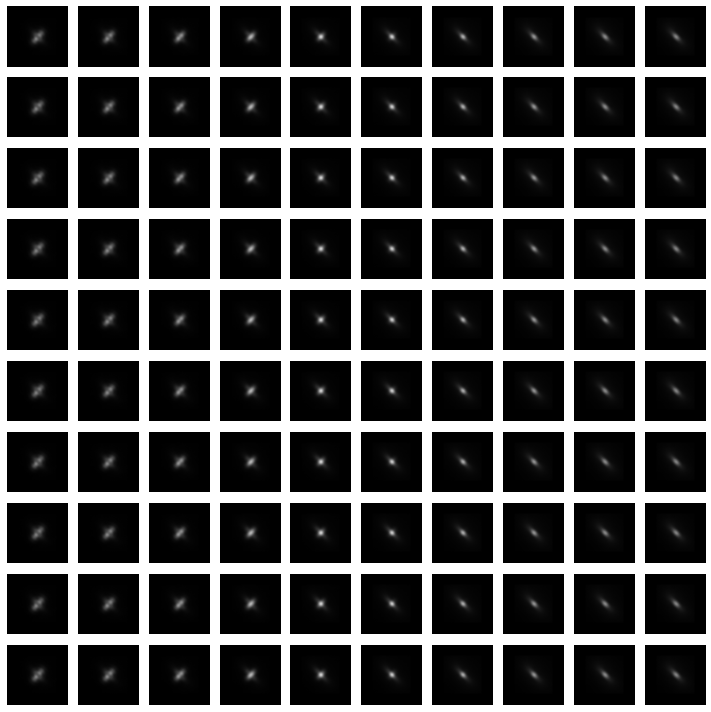

In [58]:

n_steps = 10

xyz = torch.ones((n_steps,3))*32
zs = torch.linspace(-2, 2, n_steps).view(-1,).to(device)

if z_dim == 2:
    zs = torch.stack((zs.repeat(n_steps), zs.repeat_interleave(n_steps)), dim=1)

model.eval()
images = model.decoder(zs)
mus, logvar = model.encoder(images)
images = images.cpu().detach().numpy()

fig, axs = plt.subplots(10,10, figsize=(10,10), layout='tight')
for j in range(images.shape[0]):
    ax = axs[j//10][j%10]
    ax.imshow(images[j,0,...], cmap='gray', vmin=0, vmax=1)
    ax.axis('off')
    #ax.set_title(f'z = {zs[j].item():.2} ({mus[j].item():.2}, {logvar[j].item():.2})')

plt.savefig(f'/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/varied_intensities/Resnet_traverseZ_B{beta}_I{vary_intensity}_P{vary_position}_N{noise_scale}_zDim{z_dim}_VAE_z_45deg_{epoch}.png', transparent=False)



In [ ]:

lr = 0.001
model = model_conv_bigger.VAE_CNN_version_2().to(device)
optimizer = optim.AdamW(model.parameters(), lr=lr)
criterion = nn.BCELoss(reduction='sum')
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer,
                                                         mode='min',
                                                         factor=0.2,
                                                         patience=20,
                                                         min_lr=5e-5)


In [54]:
model = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
state_dict = torch.load("/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B2_VAE_z_only_200.pt")
model.load_state_dict(state_dict)


173056
(64, 64)


<All keys matched successfully>

In [40]:
def plot_traverse_mu(model_noise):
    model = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
    model.load_state_dict(torch.load(f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B1_noise2noise_noise{model_noise}_VAE_z_only_45deg_3000.pt"))


    beta = 1
    n_steps =20

    xyz = torch.ones((n_steps,3))*32
    zs = torch.linspace(-4, 4, n_steps).view(-1,1).to(device)

    model.eval()

    images = model.decoder(zs)
    mus, logvar = model.encoder(images)
    images = images.cpu().detach().numpy()
    std = torch.exp(0.5*logvar)
    fig, axs = plt.subplots(2,10, figsize=(30,10))
    for i in range(images.shape[0]):
        ax = axs[i//10][i%10]
        ax.imshow(images[i,0,...], cmap='gray', vmin=0.0, vmax=1.0)
        ax.axis('off')
        ax.set_title(f'z = {zs[i].item():.2} ({mus[i].item():.2}, {std[i].item():.2})', fontsize=15)
    fig.suptitle(f'Trained with noise = {model_noise}', fontsize=20)
    plt.show()

173056
(64, 64)


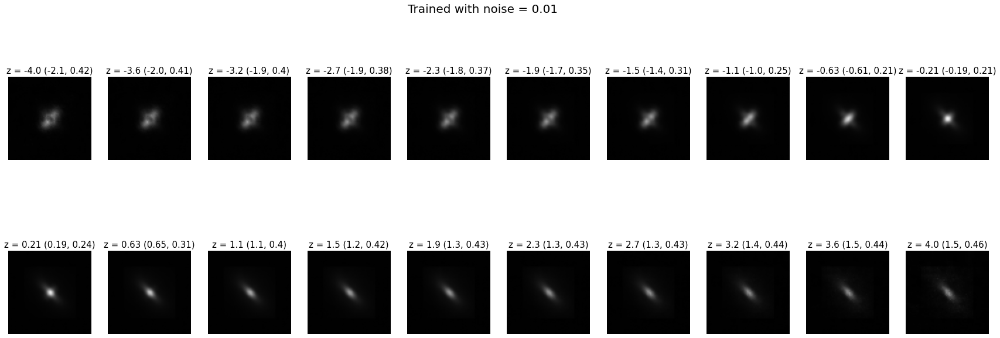

173056
(64, 64)


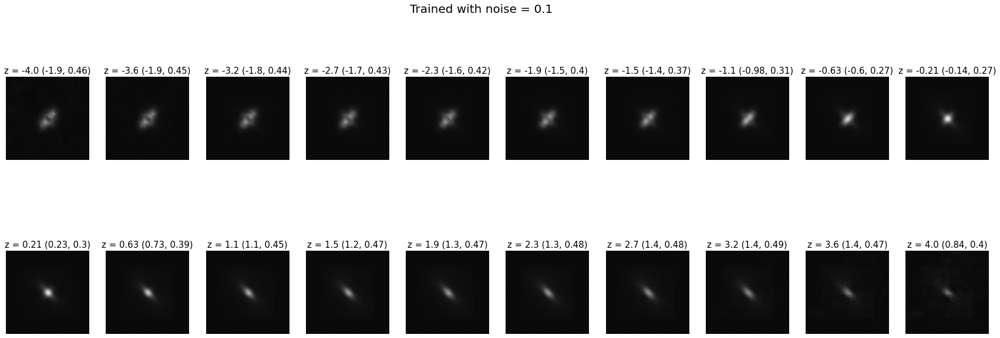

173056
(64, 64)


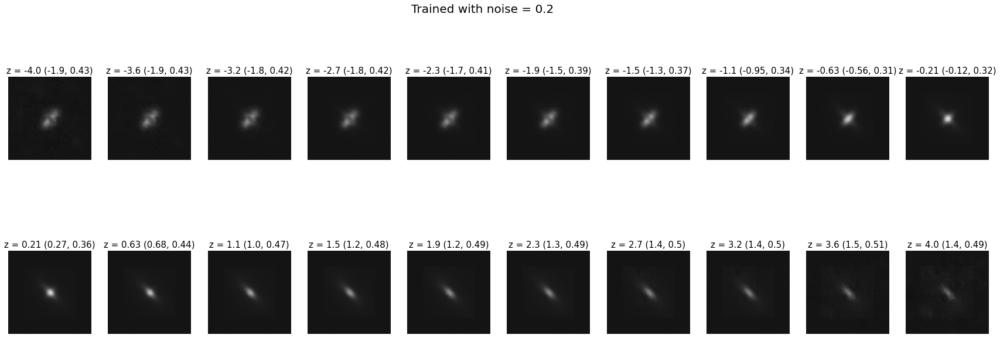

173056
(64, 64)


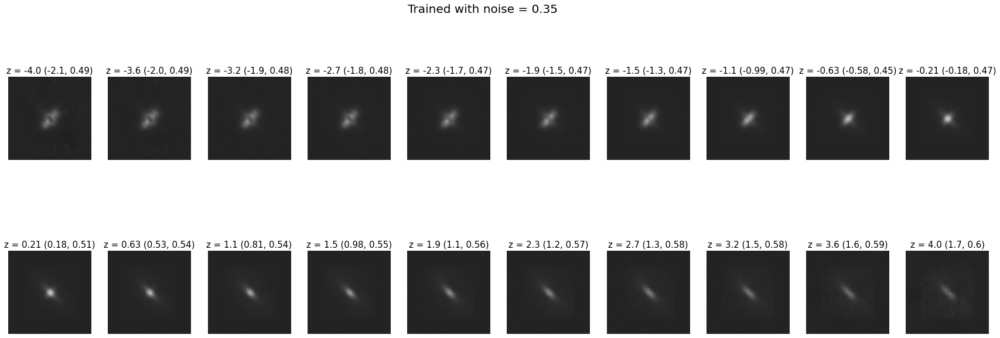

173056
(64, 64)


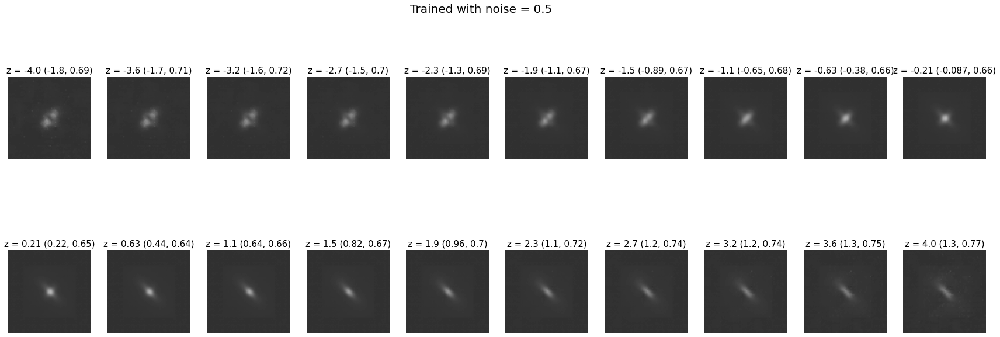

In [41]:

model_noises = [0.01, 0.1, 0.2, 0.35, 0.5]


for model_noisy in model_noises:
    plot_traverse_mu(model_noisy)

In [38]:
def plot_reconstruction(model_noise):
    plt. rcParams["figure.figsize"] = (20,10)

    model = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
    model.load_state_dict(torch.load(f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B1_noise2noise_noise{model_noise}_VAE_z_only_45deg_3000.pt"))

    model.to(device)

    noise_scale = model_noise
    nr = 10

    model.eval()
    
    xyz = torch.ones((nr,3))*32
    xyz[...,2] = torch.linspace(-500, 500, nr)
    xyz = xyz.view(1, -1, 3)
    photon_scale = 1000
    #photons = torch.rand((xyz.shape[1], 1))*photon_scale
    photons = torch.ones((xyz.shape[1], 1))*photon_scale
    frames = torch.cat([psf.forward(xyz[:,i,...], photons[i]) for i in range(xyz.shape[1])])
    max_val = torch.max(frames)
    noise = torch.normal(0.0,noise_scale*max_val,(frames.shape))
    noisy = frames + noise
    frames = frames/max(21.28, max_val)
    noisy = noisy/max(21.28, max_val)
    noisy[noisy>1] = 1.0
    noisy[noisy<0] = 0.0

    frames = frames.view(frames.shape[0],1,frames.shape[1], frames.shape[2])
    noisy = noisy.view(noisy.shape[0],1,noisy.shape[1], noisy.shape[2])

    frames = frames.to(device)
    noisy = noisy.to(device)
    reconstruction, mu, logvar, z = model(noisy)
    print(f'z: {z.view(1, -1)}')
    frames = frames.cpu().detach()
    noisy = noisy.cpu().detach()
    reconstruction = reconstruction.cpu().detach()
    both = torch.cat((noisy.view(nr, 1, 64, 64),frames.view(nr, 1, 64, 64), 
                                  reconstruction.view(nr, 1, 64, 64)))
    grid =torchvision.utils.make_grid(both, nrow=10)
    show(grid, title=f'Reconstruction from noisy -500 to 500')

173056
(64, 64)
z: tensor([[-1.3283, -0.8142, -0.1260, -0.1775,  0.3092,  0.3176,  0.2554,  2.3768,
          0.1568,  0.8565]], device='cuda:0', grad_fn=<ViewBackward0>)
173056
(64, 64)
z: tensor([[-0.8003, -1.7299, -1.1452,  0.8534,  0.3362,  0.5547,  1.2719,  0.6191,
          1.6592,  0.3995]], device='cuda:0', grad_fn=<ViewBackward0>)
173056
(64, 64)
z: tensor([[-0.3659, -1.6275,  0.3816,  0.4928,  0.3084,  0.4339,  1.8717,  0.5573,
          0.6354,  1.0538]], device='cuda:0', grad_fn=<ViewBackward0>)
173056
(64, 64)
z: tensor([[-0.4071,  0.2367,  1.7402,  0.5307,  0.3935,  0.4169,  1.1532,  0.5591,
          1.7322,  1.0567]], device='cuda:0', grad_fn=<ViewBackward0>)
173056
(64, 64)
z: tensor([[-0.5087, -1.5219,  1.1173, -0.5185,  0.6912, -0.2288,  0.9685,  1.5924,
          1.8848,  1.2623]], device='cuda:0', grad_fn=<ViewBackward0>)


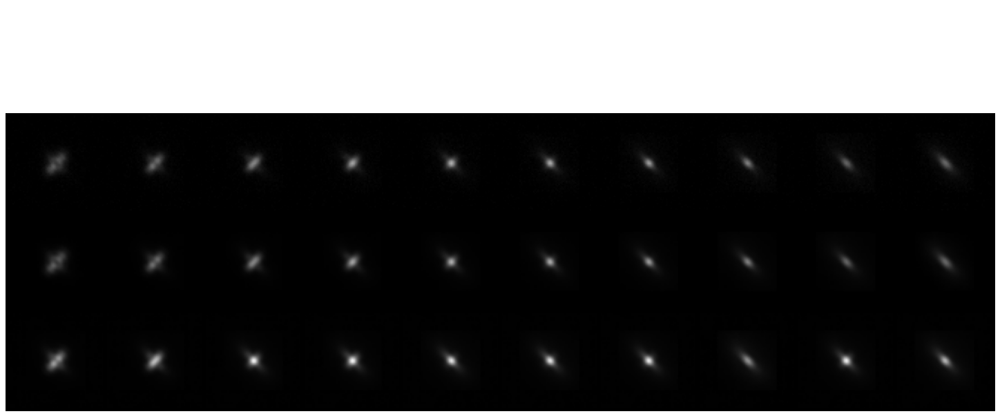

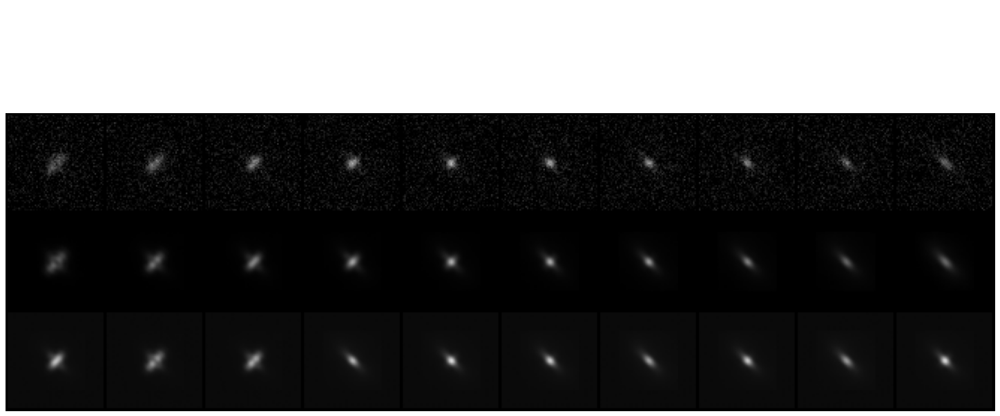

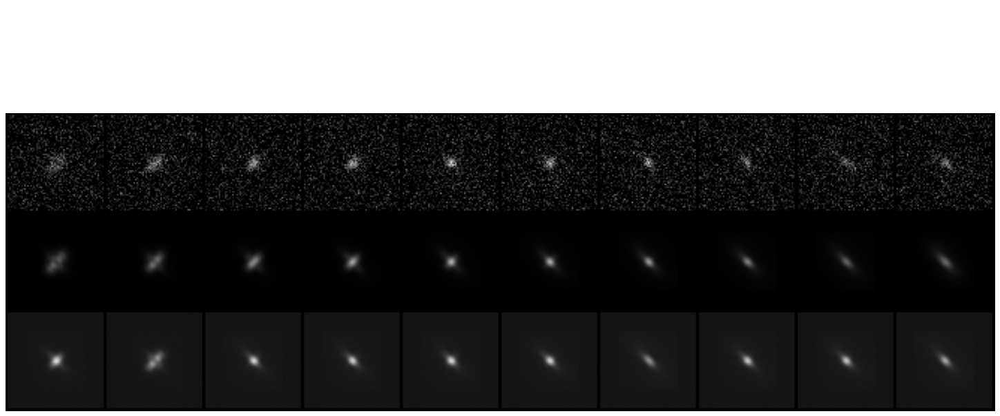

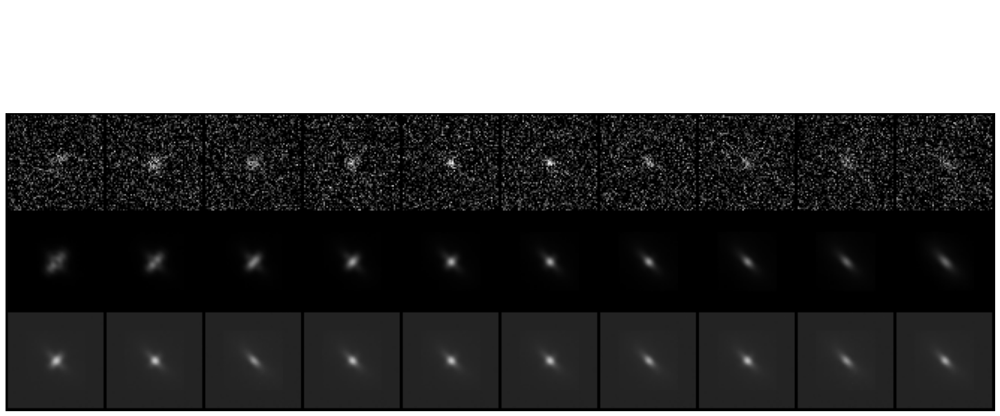

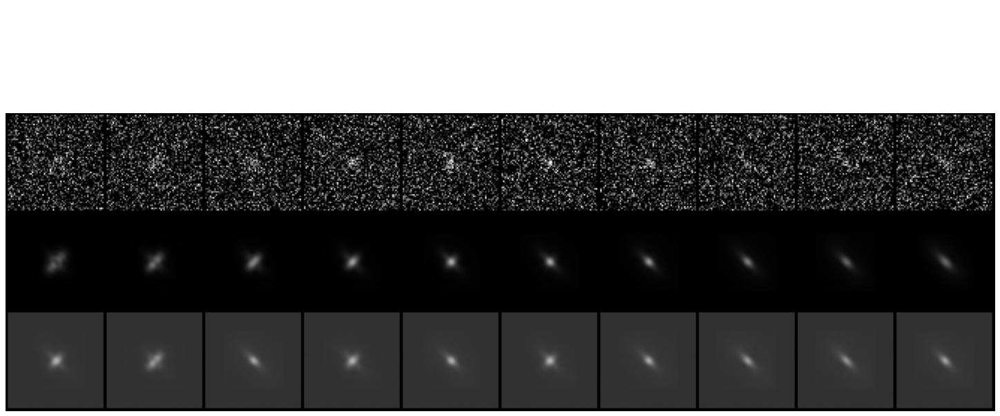

In [39]:
model_noises = [0.01, 0.1, 0.2, 0.35, 0.5]

for model_noisy in model_noises:
    plot_reconstruction(model_noisy)

In [42]:
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300


In [26]:
def plot_z_v_mu(model_noise, noise_scales):
    fig, axs = plt.subplots(3,2, constrained_layout=True)
    model = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
    model.load_state_dict(torch.load(f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B1_noise2noise_noise{model_noise}_VAE_z_only_45deg_3000.pt"))
    plt.setp(axs, xticks=list(range(-500, 600,100)))
    beta = 1


    for j in range(len(noise_scales)):
        noise_scale = noise_scales[j]

        images, noisy, xys, _ = create_psf_batch(batch_size=100, noise_scale=noise_scale)
        model.eval()
        noisy = noisy.to(device)
        mu, logvar = model.encoder(noisy)
        #reconstruction, mu, logvar, _ = model(noisy)
        all_xys = xys
        all_mus = mu
        all_std = torch.exp(0.5*logvar)
        for i in range(100):
            images, noisy, xys, _ = create_psf_batch(batch_size=100, noise_scale=noise_scale)
            model.eval()
            
            noisy = noisy.to(device)
            mu, logvar = model.encoder(noisy)
            #reconstruction, mu, logvar, _ = model(noisy)
            #del reconstruction
            del images
            
            all_xys = torch.cat((all_xys, xys), dim=1)
            del xys
            all_mus = torch.cat((all_mus, mu), dim=0)
            all_std = torch.cat((all_std, torch.exp(0.5*logvar)))


        predicted = all_mus[:,0].cpu().detach().numpy()
        stds = all_std[:,0].cpu().detach().numpy()
        x = all_xys[0,:,2]
        if stds.max() < 10:
            axs[j//2][j%2].plot(x, stds,'o', alpha=0.01, c='r',label="Standard deviation")

        axs[j//2][j%2].plot(x, predicted,'o', alpha=0.05,c='blue', label="Mean")

        axs[j//2][j%2].set_title(f"beta={beta}, noise: {noise_scale}", fontsize=18)
        axs[j//2][j%2].set_xlabel("z", fontsize=18)
        axs[j//2][j%2].set_ylabel("mu", fontsize=18)
        
        leg = axs[j//2][j%2].legend(fontsize=16)
        for lh in leg.legend_handles: 
            lh.set_alpha(1)
    fig.suptitle(f"VAE z only trained with {model_noise} noise", fontsize=20)
    plt.show()
    return predicted, x

In [204]:


noise_scales = [0,0.01, 0.1, 0.2, 0.35, 0.5]
model_noises = [0.01, 0.1, 0.2, 0.35,  0.5]

for model_noisy in model_noises:
    plot_z_v_mu(model_noisy, noise_scales)


type: name 'plot_z_v_mu' is not defined

173056
(64, 64)


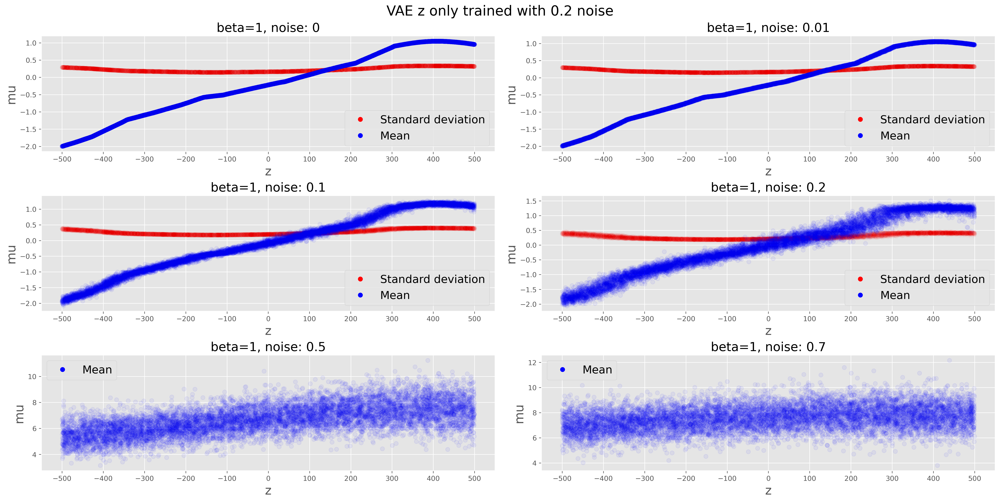

173056
(64, 64)


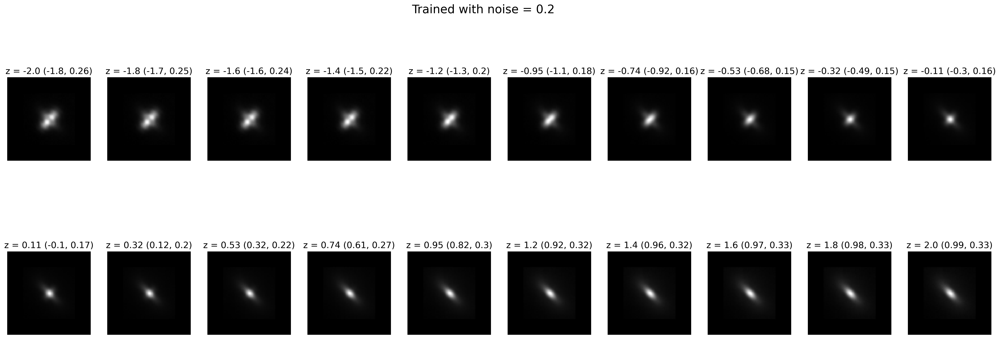

173056
(64, 64)


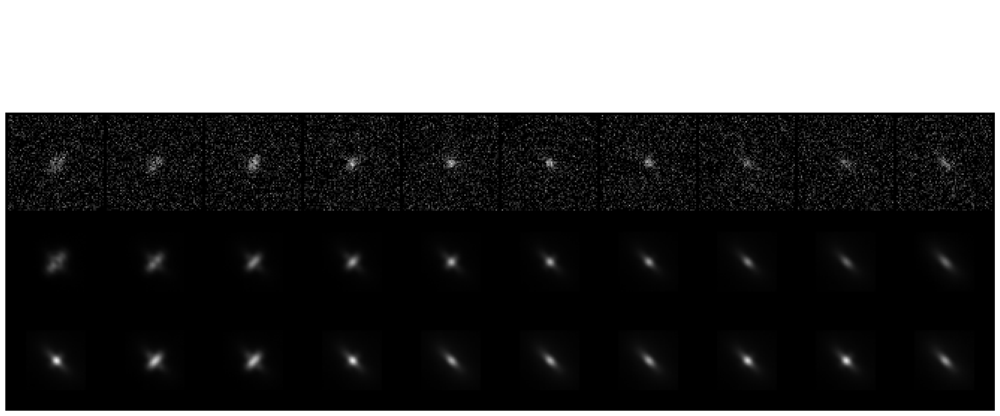

In [143]:
noise_scales = [0,0.01, 0.1, 0.2, 0.5, 0.7]
model_noisy = 0.2

plot_z_v_mu(model_noisy, noise_scales)
plot_traverse_mu(model_noisy)
plot_reconstruction(model_noisy)


173056
(64, 64)
173056
(64, 64)
173056
(64, 64)


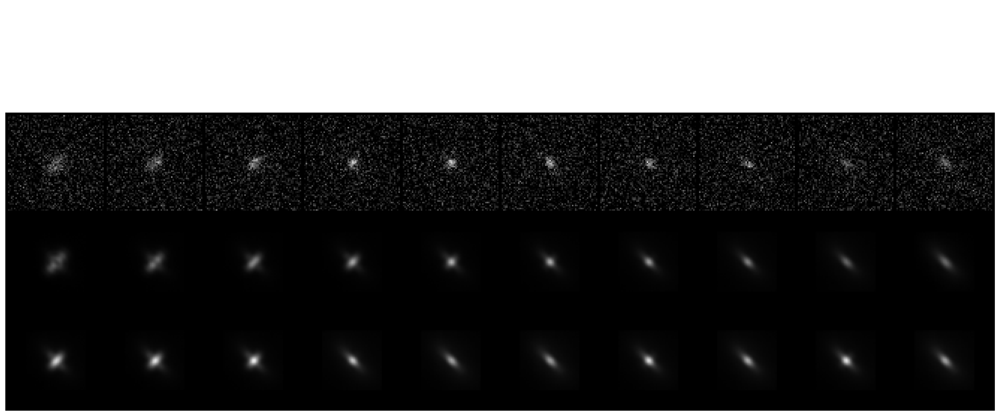

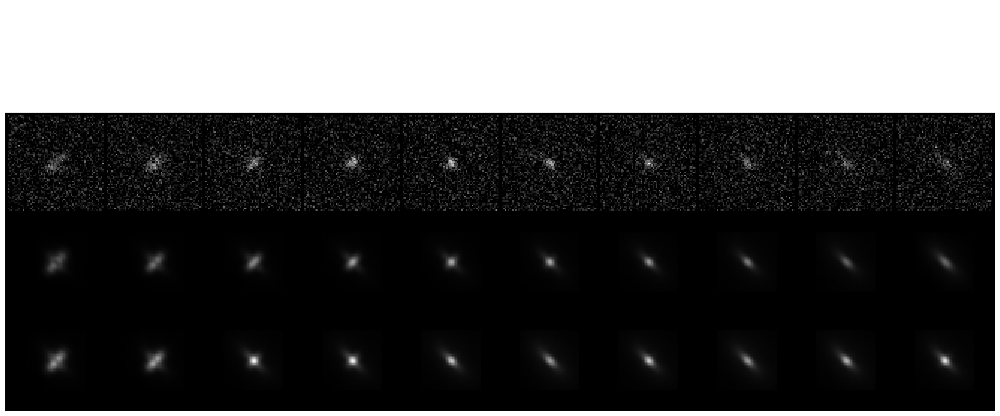

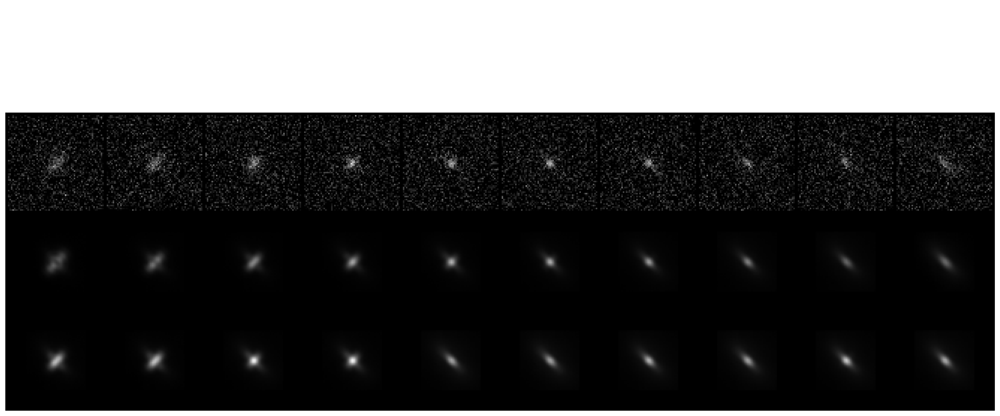

In [78]:
plot_reconstruction(model_noisy)
plot_reconstruction(model_noisy)
plot_reconstruction(model_noisy)


(array([284.,  72.,  63.,  51.,  55.,  48.,  31.,  47.,  65., 294.]),
 array([-0.46525842, -0.34745276, -0.2296471 , -0.11184144,  0.00596422,
         0.12376988,  0.24157554,  0.3593812 ,  0.47718686,  0.59499252,
         0.71279818]),
 <BarContainer object of 10 artists>)

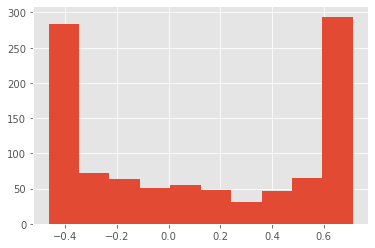

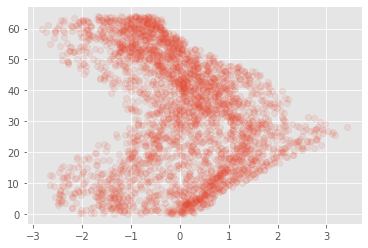

In [183]:
predicted = all_mus[both_in,1].cpu().detach().numpy()
x = all_xys[0,both_in,0]
plt.plot(predicted, x, 'o', alpha=0.1)


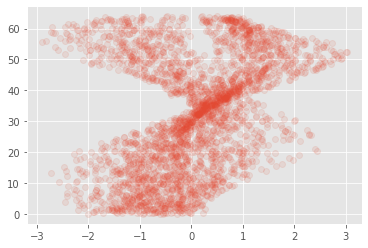

In [182]:
predicted = all_mus[both_in,2].cpu().detach().numpy()
x = all_xys[0,both_in,1]
plt.plot(predicted, x, 'o', alpha=0.1)


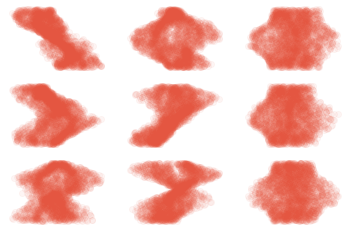

In [ ]:

plt.plot(all_mus[:,1].cpu().detach().numpy(), all_mus[:,2].cpu().detach().numpy(), 'o', alpha=1)

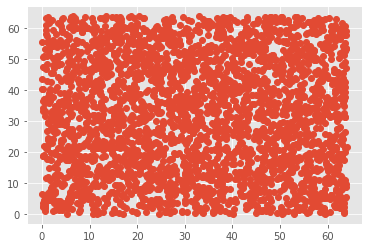

In [102]:
import torch
import torch.nn as nn
import torch.nn.functional as F

plt.plot(all_xys[0,:,0].cpu().detach().numpy(), all_xys[0,:,1].cpu().detach().numpy(), 'o', alpha=1)


In [37]:
images.max()

tensor(2.1374, device='cuda:0')

In [ ]:
#both = torch.cat((data.view(batch_size, 1, 64, 64)[:8], 
                    reconstruction.view(batch_size, 1, 64, 64)[:8]))
#save_image(both.cpu(), f"../outputs/psf_output{epoch}.png", nrow=num_rows)


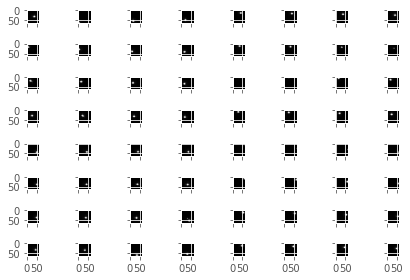

In [144]:
model.eval()
fig, axs = plt.subplots(8,8, sharex=True, sharey=True)
# decoding
fig.tight_layout()
for i in range(-4,4):
    for j in range(-4,4):
        z = torch.tensor([[float(i),float(j)]]).cuda()
        axs[i,j].imshow(reconstruction.view((64, 64)).cpu().detach().numpy(), cmap='gray')

plt.show()


In [137]:
reconstruction.view((64, 64))

tensor([[0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 4.0368e-01, 3.2587e-01,
         2.6970e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 6.7344e-01, 4.9652e-01,
         3.5723e-01],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 9.4673e-01, 8.1915e-01,
         6.0063e-01],
        ...,
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 2.4258e-36, 3.9615e-36,
         4.5398e-36],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 5.4501e-39, 7.5286e-39,
         5.2027e-39],
        [0.0000e+00, 0.0000e+00, 0.0000e+00,  ..., 0.0000e+00, 0.0000e+00,
         0.0000e+00]], device='cuda:0', grad_fn=<ViewBackward0>)

In [156]:
from sklearn.linear_model import LinearRegression
import pandas as pd
from statsmodels.formula.api import ols
predictions = all_mus[both_in,:].cpu().detach().numpy()
X = np.array(all_xys[0,both_in,:2])



train_X, test_X, train_Y, test_Y = skl.model_selection.train_test_split(predictions, X, test_size=0.2)
reg = LinearRegression().fit(np.concatenate([train_X, train_X**2], axis=1), train_Y)
error = np.sqrt(np.mean((reg.predict(np.concatenate([test_X, test_X**2], axis=1)) - test_Y)**2))
print(error)

10.768504


In [154]:
df = pd.DataFrame(np.concatenate([predictions, X], axis=1), columns=["mux", "muy", "X", "Y"])
df

,mux,muy,X,Y
0,0.590835,-1.088881,33.769619,43.261154
1,-0.235529,-0.463075,54.439774,59.142441
2,-0.100780,0.574154,11.446047,17.861872
3,0.686940,-0.091562,28.948713,24.942631
4,-0.082744,0.470603,13.443804,19.228218
...,...,...,...,...
9241,0.283223,-1.349000,38.934818,42.622536
9242,0.330101,-0.425184,28.774563,54.524624
9243,0.308841,0.478308,13.271326,27.912254
9244,-0.767542,2.720012,50.244900,12.440348


In [157]:
model = ols("X, Y ~ mux + muy", data=df)

type: Number of rows mismatch between data argument and X, Y (9246 versus 2)
    X, Y ~ mux + muy
    ^^^^

In [86]:
mus = torch.cat((torch.arange(-2,3,0.5).repeat(10).view(-1,1),torch.arange(-2,3,0.5).repeat_interleave(10).view(-1,1)),1)

In [87]:
model.eval()
z = mus.float().cuda()

reconstruction = model.decoder(z)


In [88]:
save_image(reconstruction.view((10*10, 1, 64,64)).cpu(), f"../outputs/conv_out/psf_beta4_test_values.png", nrow=10, pad_value=1)

In [204]:
reconstruction.shape

torch.Size([169, 4096])

In [130]:
from model_2_layer import bigger_nn
simple_model = bigger_nn(in_features=1, out_features=1)
lr = 0.001
optimizer_simple = optim.Adam(simple_model.parameters(), lr=lr)
loss_simple = nn.MSELoss()

Hej


In [131]:
def fit_simple(simple_model, train_X, train_Y):
    simple_model.train()
    running_loss = 0.0
    train_X = train_X.to(device)
    train_Y = train_Y.to(device)    
    batch_size = 64
    for i in range(len(train_X)//batch_size):
        data = train_X[i*batch_size:(i+1)*batch_size]
        gt = train_Y[i*batch_size:(i+1)*batch_size]
        optimizer_simple.zero_grad()
        output = simple_model(data)
        loss = loss_simple(output, gt)
        running_loss += loss.item()
        loss.backward()
        optimizer_simple.step()

    train_loss = running_loss/len(train_X)
    return train_loss



In [132]:
def validate_simple(model, test_X, test_y):
    model.eval()
    running_loss = 0.0
    batch_size = 64
    test_X = test_X.to(device)
    test_y = test_y.to(device)    


    with torch.no_grad():
        for i in range(len(test_X)//batch_size):
            data = test_X[i*batch_size:(i+1)*batch_size]
            gt = test_y[i*batch_size:(i+1)*batch_size]
            output = simple_model(data)
            loss = loss_simple(output, gt)
            running_loss += loss.item()

    val_loss = running_loss/len(test_X)
    return val_loss

173056
(64, 64)


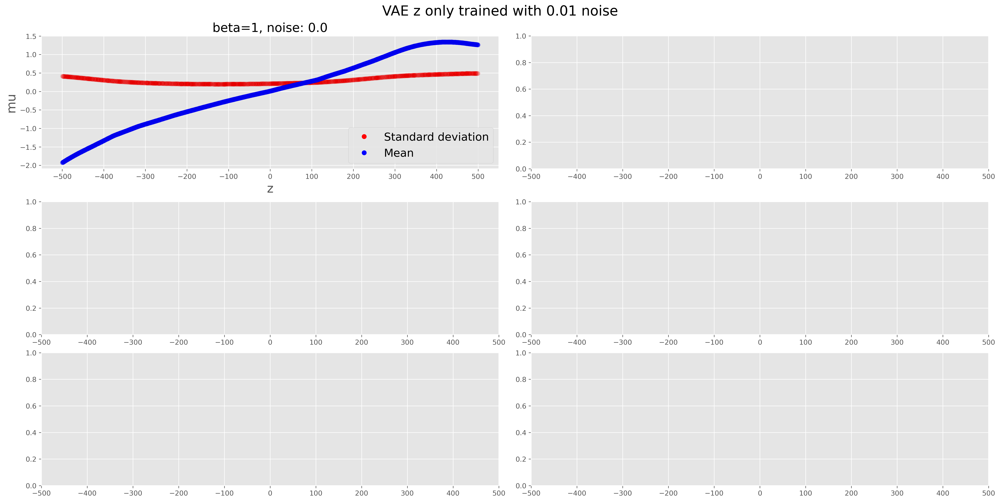

/tmp/ipykernel_927639/1937987956.py:11: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  train_Y = torch.tensor(train_Y).view(-1, 1)
/tmp/ipykernel_927639/1937987956.py:12: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  test_Y = torch.tensor(test_Y).view(-1, 1)


In [145]:
import sklearn.model_selection as model_selection
model_noisy = 0.01
predictions, X = plot_z_v_mu(model_noisy, [0.0])

train_X, test_X, train_Y, test_Y = model_selection.train_test_split(predictions, X, test_size=0.2, shuffle=True, random_state=42)
#loss_vec = []
#val_loss_vec = []
simple_model.to(device)
train_X = torch.tensor(train_X).view(-1, 1)
test_X = torch.tensor(test_X).view(-1, 1)
train_Y = torch.tensor(train_Y).view(-1, 1)
test_Y = torch.tensor(test_Y).view(-1, 1)
#train_X = train_X.detach()
#test_X = test_X.detach()
for epoch in range(500):
    loss = fit_simple(simple_model, train_X, train_Y)
    loss_vec.append(loss)
    val_loss = validate_simple(simple_model, test_X, test_Y)
    val_loss_vec.append(val_loss)
    

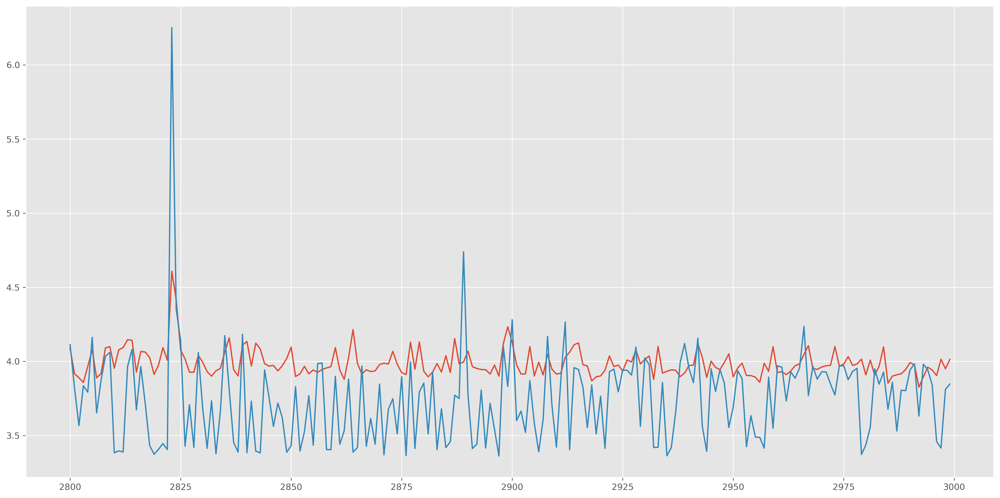

In [151]:
plt.plot(list(range(len(loss_vec)))[2800:], loss_vec[2800:])
plt.plot(list(range(len(loss_vec)))[2800:], val_loss_vec[2800:])

In [101]:
np.sqrt(val_loss_vec[-1])

0.6587733752300137

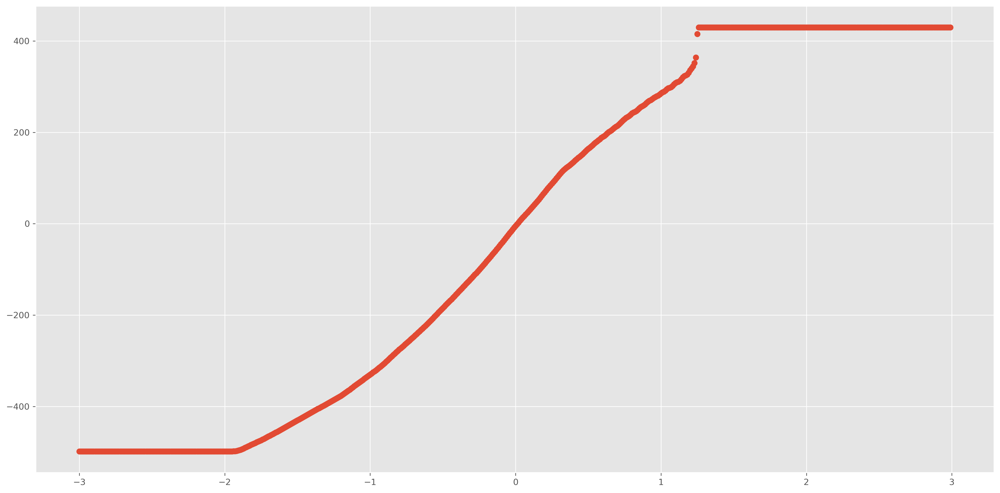

In [152]:
simple_model.eval()
x = torch.arange(-3, 3, 0.01).view(-1, 1)
y = simple_model(x.to(device))

plt.plot(x, y.detach().cpu().numpy(), 'o')

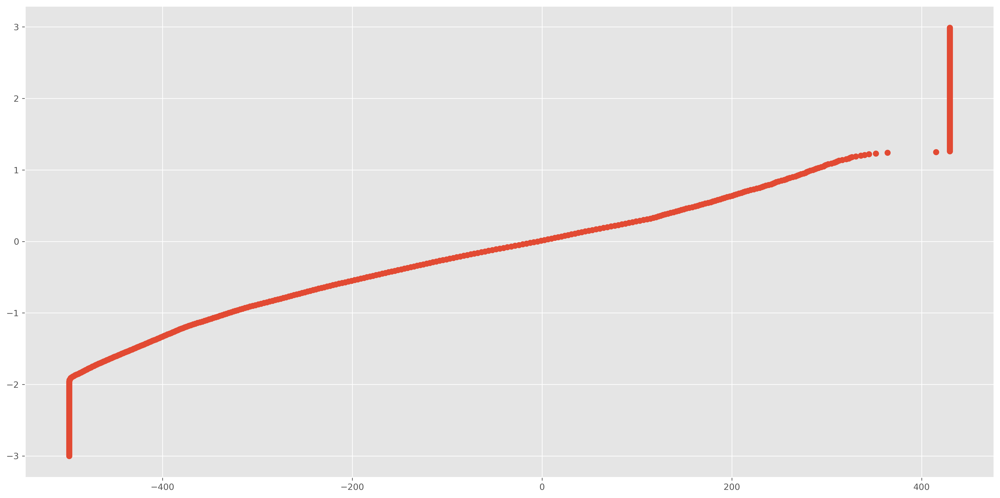

In [150]:
plt.plot(y.detach().cpu().numpy(), x, 'o')

173056
(64, 64)
173056
(64, 64)


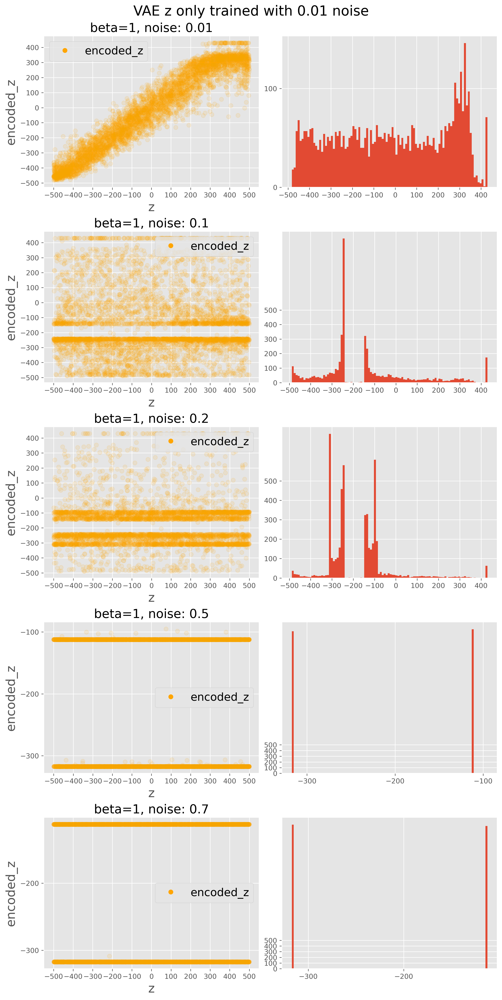

173056
(64, 64)
173056
(64, 64)


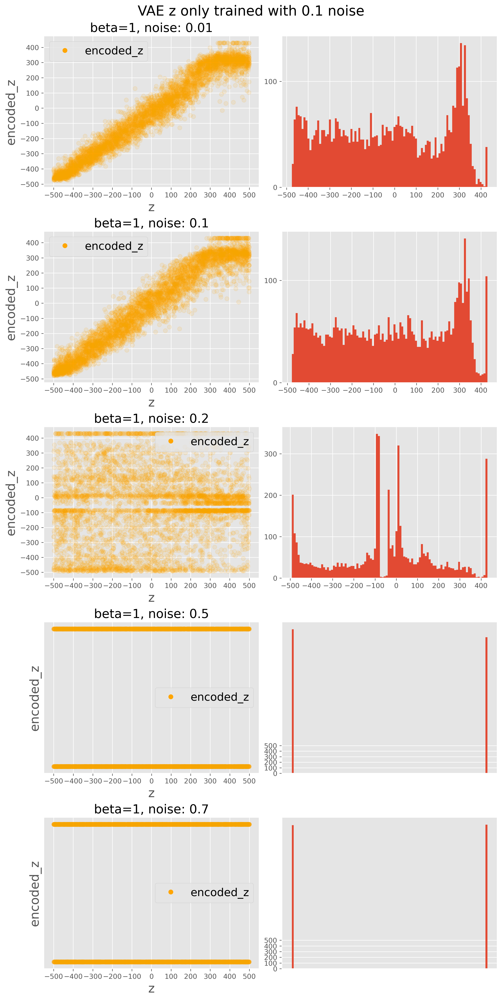

173056
(64, 64)
173056
(64, 64)


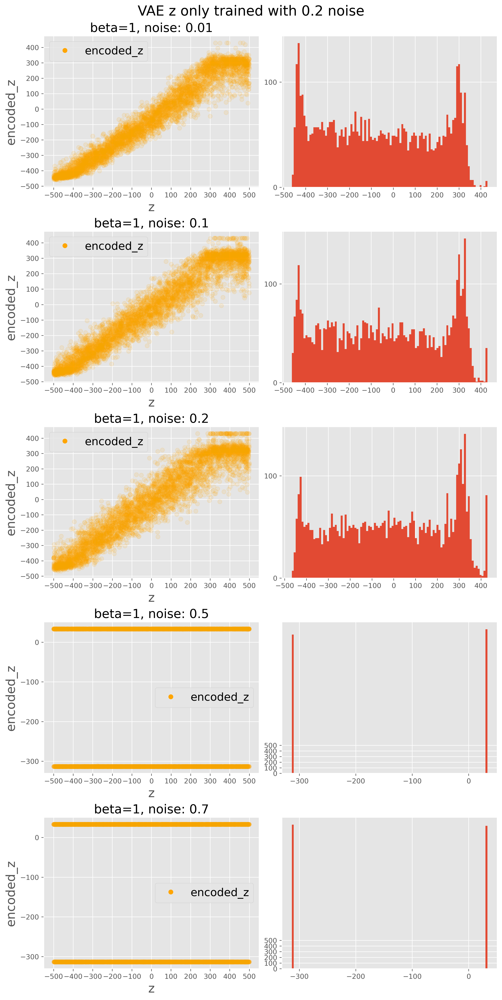

173056
(64, 64)
173056
(64, 64)


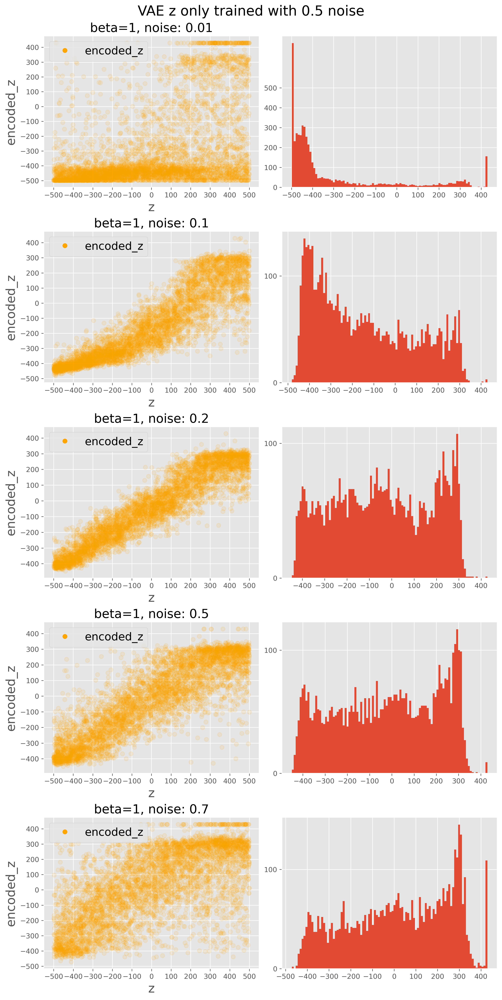

173056
(64, 64)
173056
(64, 64)


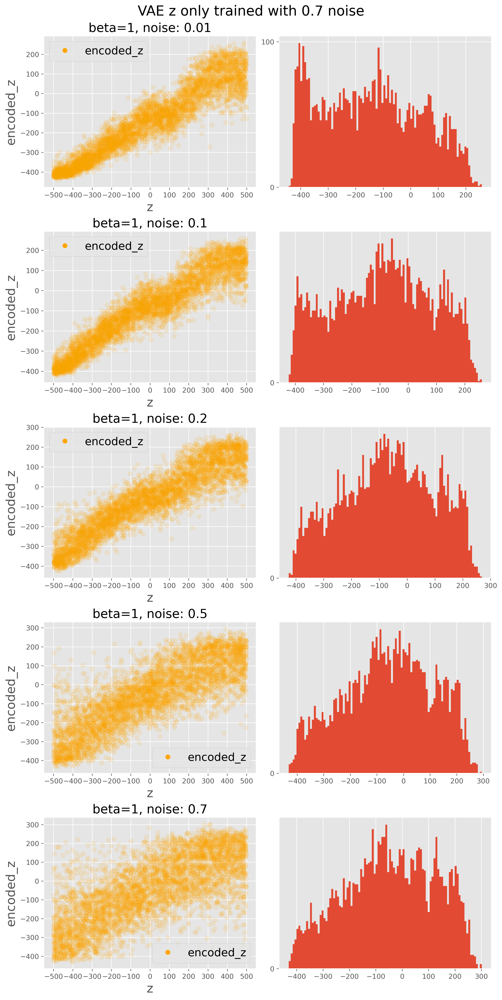

In [168]:

model_noise = 0.2

for model_noise in [0.01, 0.1, 0.2, 0.5, 0.7]:

    model_noisy = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
    model_noisy.load_state_dict(torch.load(f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B1_noise{model_noise}_VAE_z_only_45deg_2000.pt"))
    model_no_noise = model_conv_bigger.VAE_CNN_version_2(zDim=1).to(device)
    model_no_noise.load_state_dict(torch.load(f"/home/axtr7550/Chromosome_project/cellbgnet/Axel_notebook/VAE_tutorial/outputs/models/Resnet_B1_noise0.01_VAE_z_only_45deg_2000.pt"))



    beta = 1
    noise_scales = [0.01, 0.1, 0.2, 0.5, 0.7]
    jmax =len(noise_scales)
    fig, axs = plt.subplots(jmax,2, constrained_layout=True, figsize=(10, 20))
    
    plt.setp(axs, xticks=list(range(-500, 600,100)))
    plt.setp(axs, yticks=list(range(-500, 600,100)))

    for j in range(0, jmax):
        noise_scale = noise_scales[j]

        images, noisy, xys, _ = create_psf_batch(batch_size=50, noise_scale=noise_scale)
        model_noisy.eval()
        model_no_noise.eval()
        noisy = noisy.to(device)
        #mu, logvar = model.encoder(noisy)
        reconstruction, mu, logvar, _ = model_noisy(noisy)
        encoded_reconstruction, _ = model_no_noise.encoder(reconstruction)
        all_no_noise_mu = simple_model(encoded_reconstruction)

        all_xys = xys
        all_mus = mu
        all_std = torch.exp(0.5*logvar)
        for i in range(100):
            images, noisy, xys, _ = create_psf_batch(batch_size=50, noise_scale=noise_scale)
            model.eval()
            
            noisy = noisy.to(device)
            #mu, logvar = model.encoder(noisy)
            reconstruction, mu, logvar, _ = model_noisy(noisy)
            encoded_reconstruction, _ = model_no_noise.encoder(reconstruction)

            no_noise_mu = simple_model(encoded_reconstruction)


            del reconstruction
            del images
            all_no_noise_mu = torch.cat((all_no_noise_mu, no_noise_mu), dim=0)
            all_xys = torch.cat((all_xys, xys), dim=1)
            del no_noise_mu
            del xys
            all_mus = torch.cat((all_mus, mu), dim=0)
            all_std = torch.cat((all_std, torch.exp(0.5*logvar)))


        predicted = all_mus[:,0].cpu().detach().numpy()
        stds = all_std[:,0].cpu().detach().numpy()
        encoded_mu = all_no_noise_mu[:,0].cpu().detach().numpy()
        x = all_xys[0,:,2]
        #if stds.max() < 10:
        #   axs[j//2][j%2].plot(x, stds,'o', alpha=0.01, c='r',label="Standard deviation")

        #axs[j//2][j%2].plot(x, predicted,'o', alpha=0.05,c='blue', label="Mean")
        axs[j][0].plot(x, encoded_mu,'o', alpha=0.1,c='orange', label="encoded_z")

        axs[j][0].set_title(f"beta={beta}, noise: {noise_scale}", fontsize=18)
        axs[j][0].set_xlabel("z", fontsize=18)
        axs[j][0].set_ylabel("encoded_z", fontsize=18)
        axs[j][1].hist(encoded_mu, bins=100)
        


        leg = axs[j][0].legend(fontsize=16)
        for lh in leg.legend_handles: 
            lh.set_alpha(1)
    fig.suptitle(f"VAE z only trained with {model_noise} noise", fontsize=20)
    plt.show()
